# <u> Assignment 3: Finding Communities In Citation Graphs Using Leiden Algorithm </u>

As a part of this assignment, I analyzed the Citing-Cited list obtained from Histone Analysis as a part of Assignment 2 for discovering communities using Leiden Algorithm. 

## <u>Leiden Algorithm: Brief Summary</u>
Leiden Algorithm is an improvement on Louvain Algorithm for discovering communities in many ways:<br>
1. Unlike Louvain, the communities resulting post-Leiden analysis are guaranteed to be well connected, and the subsets of all communities are locally optimally assigned. 
2. Leiden Analysis runs faster than the Louvain Algorithm by using the 'fast-local-move' approach. 

### <u>Step 1: Upload Histone Data & Create Pandas Dataframe</u>
As a part of Step 1, 'Histone' related data is uploaded by using a csv which is read by Pandas. This data is converted to a dataframe, which is then used as an input for iGraph to create an iGraph graph object. Additional modules are also uploaded to help with the analysis. 

In [1]:
import pandas as pd
import igraph as ig
import leidenalg as la
import cairocffi as cairo

In [4]:
#csv file to be read and stored in a pandas dataframe. The columns were rearranged as igraph recognizes the first two
#columns as edge nodes. 
df = pd.read_csv('/Users/sidahuja/Dev/AlgoLeiden/code/pubmed-oc-data.csv')
df = df[['doi', 'cited', 'pmid', 'pub_year']]

At this stage, the first two columns ('doi' and 'cited') are analyzed to determine any null values. As seen in the comments
below, the 'cited' column returns 2092 'NULL' values. These rows with 'NULL' cited values will be deleted so iGraph can create a graph object.


In [6]:
df['doi'].isnull().sum()            #outputs 0
df['cited'].isnull().sum()          #outputs '2092'

2092

In [7]:
df = df.dropna(subset=['cited'])
df['cited'].isnull().sum()          #outputs 0 as desired

0

### <u> Step 2: Create iGraph Object and Feed Into Leiden Algorithm </u>

At this stage, it is necessary to import iGraph and cairocffi (which helps in plotting graph objects). To make sure that everything installed successfully, the famous network science problem 'Zachary Karate Club' graph was plotted. 

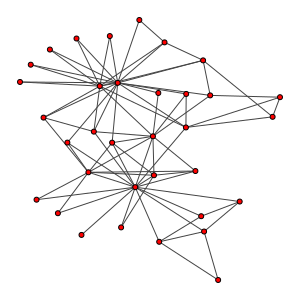

In [66]:
G = ig.Graph.Famous('Zachary')
ig.plot(G, bbox=(0,0,300,300), vertex_size=5)

Upon successfully plotting the 'Zachary' graph, I moved onto the main task involving 'Histone' dataframe. I decided to make an undirected graph from the pandas dataframe containing doi-cited data using iGraph. As mentioned previously, this graph object was then used as an input into the Leiden Algorithm.<br>

Leiden Algorithm package provides implementation for six different methods to create clusters. For this analysis, I used the method based on 'Constant-Potts' model. <br>

I chose this method because of its simplicity in defining Quality:


\begin{align}
Q = \sum_{c} \left[m_c - \gamma \binom{n_c}{2} \right]
\end{align}

where $m_c$ is the number of internal edges of community $c$, $n_c$ is the number of nodes in community $c$. As well, the definition of a community is in a sense independent of the actual graph, which is not the case for any of the other methods.



In [8]:
g = ig.Graph.DataFrame(df, directed=False)

In [33]:
partition1 = la.find_partition(g, la.CPMVertexPartition, resolution_parameter = 0.1)
ig.plot(partition1, vertex_size=3, vertex_label=None)

#### Information about clusters

I decided to not carry out plotting for the remaining iterations of clustering using resolution factor, seeing it didn't return visually sensible results. 
In the code snippets below, clustering was carried out for the graph object, with different resolution factors. The results of this clustering exercise have been compiled in the table below. <br><br>
It can be seen in the table that low resolution factors produce fewer but bigger clusters (hence 'low' resolution). High resolution factors produce more but smaller clusters (hence 'high' resolution)

In [32]:
partition2 = la.find_partition(g, la.CPMVertexPartition, resolution_parameter = 0.2)
partition3 = la.find_partition(g, la.CPMVertexPartition, resolution_parameter = 0.3)
partition4 = la.find_partition(g, la.CPMVertexPartition, resolution_parameter = 0.4)
partition5 = la.find_partition(g, la.CPMVertexPartition, resolution_parameter = 0.5)

In [38]:
from prettytable import PrettyTable

partition_summary_table = PrettyTable(['PartitionName', 'ResolutionFactor', 'NumberOfClusters', 'BiggestClusterSize'])
partition_summary_table.add_row(['Partition1', '0.1', len(partition1), partition1.giant().vcount()])
partition_summary_table.add_row(['Partition2', '0.2', len(partition2), partition2.giant().vcount()])
partition_summary_table.add_row(['Partition3', '0.3', len(partition3), partition3.giant().vcount()])
partition_summary_table.add_row(['Partition4', '0.4', len(partition4), partition4.giant().vcount()])
partition_summary_table.add_row(['Partition5', '0.5', len(partition5), partition5.giant().vcount()])

print(partition_summary_table)

+---------------+------------------+------------------+--------------------+
| PartitionName | ResolutionFactor | NumberOfClusters | BiggestClusterSize |
+---------------+------------------+------------------+--------------------+
|   Partition1  |       0.1        |      14629       |         58         |
|   Partition2  |       0.2        |      24077       |         35         |
|   Partition3  |       0.3        |      26828       |         27         |
|   Partition4  |       0.4        |      29339       |         23         |
|   Partition5  |       0.5        |      31569       |         15         |
+---------------+------------------+------------------+--------------------+


### <u>Step 3: Randomizing DataFrame and Corresponding Leiden Analysis</u>

I chose the resolution factor of 0.2 to analyze the randomized dataframe containing Histone data.As seen in the Leiden Analysis below, the resolution factor of 0.2 produced 23,990 clusters with the biggest cluster containing 37 nodes. 

In [28]:
#sh_df = shuffled dataframe
sh_df = df.sample(frac=1).reset_index(drop=True)

In [40]:
#create iGraph object
sh_g = ig.Graph.DataFrame(sh_df, directed=False)

#run Leiden Algorithm with resolution factor = 0.2
sh_partition2 = la.find_partition(sh_g, la.CPMVertexPartition, resolution_parameter = 0.2)


In [41]:
sh_partition_summary_table = PrettyTable(['PartitionName', 'ResolutionFactor', 'NumberOfClusters', 'BiggestClusterSize'])
sh_partition_summary_table.add_row(['sh_partition2', '0.2', len(sh_partition2), sh_partition2.giant().vcount()])

print(sh_partition_summary_table)

+---------------+------------------+------------------+--------------------+
| PartitionName | ResolutionFactor | NumberOfClusters | BiggestClusterSize |
+---------------+------------------+------------------+--------------------+
| sh_partition2 |       0.2        |      23990       |         37         |
+---------------+------------------+------------------+--------------------+


### <u>Step 4: Visualizing Clusters</u>
Since the CPM Method of clustering provides us with best community networks in the first go, I used it to invetigate individual clusters obtained in the last step (applying CPM method would not further partition our communities, so they remain clustered). The results were then plotted using iGraph. 

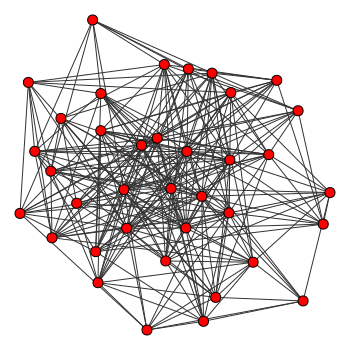

In [61]:
#community 1 (cluster 1 in the shuffled partition)
sh_g1 = sh_partition2.subgraph(0)
sh1 = la.find_partition(sh_g1, la.CPMVertexPartition, resolution_parameter = 0.2)
ig.plot(sh1, bbox=(0,0,350, 350), vertex_size=10)

More information about this community can be obtained using the summary method.<br>This method of visualizing information can be extended to other clusters, which will provide us the individual elements of the clusters and the size. 

In [65]:
sh1.summary(verbosity=1)

'Clustering with 37 elements and 1 clusters\n10.1016/0012-1606(74)90052-9, 10.1016/0012-1606(79)90144-1, 10.1016/0012-1606(81)90069-5, 10.1016/0012-1606(81)90485-1, 10.1016/0012-1606(82)90359-1, 10.1016/0012-1606(82)90360-8, 10.1016/0012-1606(83)90211-7, 10.1016/0012-1606(83)90340-8, 10.1016/0012-1606(84)90161-1, 10.1016/0012-1606(84)90162-3, 10.1016/0012-1606(85)90129-0, 10.1016/0012-1606(87)90228-4, 10.1016/0012-1606(88)90188-1, 10.1016/0012-1606(89)90229-7, 10.1016/0022-2836(84)90088-3, 10.1016/0092-8674(78)90111-3, 10.1016/0092-8674(78)90118-6, 10.1016/0092-8674(78)90287-8, 10.1016/0092-8674(81)90048-9, 10.1016/0092-8674(82)90132-5, 10.1016/s0074-7696(08)61061-x, 10.1021/bi00580a004, 10.1038/292477a0, 10.1038/301120a0, 10.1038/310312a0, 10.1073/pnas.81.8.2411, 10.1101/gad.3.7.973, 10.1126/science.1237932, 10.1126/science.6178156, 10.1128/mcb.10.12.6730-6741.1990, 10.1128/mcb.6.11.3746-3754.1986, 10.1128/mcb.6.7.2602-2612.1986, 10.1128/mcb.7.1.478-485.1987, 10.1128/mcb.8.3.1236-1246

## <u>Conclusion</u>
The aim for this exercise was to analyze Histone data curated in Assignment 1 by identifying communities of papers that are connected via citations. Leiden Algorithm was used to carry out this analysis, since it is known to output strongly connected communities in less time. The result of this study showed that different cluster sizes can be obtained by varying the resolution parameter. While resolution parameter of 0.1 produced fewer but larger communities, higher resolution factor of 0.5 produced more but smaller communities. One inidividual community was visualized using iGraph, and the analysis showed that it contained 37 papers. This method can be extended to visualize any of the 20,000+ communities that were identified in the Histone dataset. 